In [1]:
# load required package
import numpy as np
import os
import cv2

from matplotlib import pyplot as plt

import tensorflow as tf
from keras import backend as K

from tqdm import tqdm
from functools import partial
tqdm = partial(tqdm, position=0, leave=True)

In [2]:
# load self-defined functions
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/data_generator.py /content
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/dice.py /content
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/f1_score.py /content
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/misc.py /content

from data_generator import binarize_mask, data_generator
from dice import dice_coef, dice_coef_loss
from f1_score import F1_score
from misc import convert_to_bw, plot_test_pred

In [3]:
# define paths of the training, validation, and test sets
train_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_image/train/images/'
mask_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_mask/train/masks_xbuffer/'
 
val_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_image/val/images/'
v_mask_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_mask/val/masks_xbuffer/'

test_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_image/test/images/'
t_mask_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_mask/test/masks_xbuffer/'

In [4]:
# define the desired shape of images and their masks for training
image_shape = (1024,1024)

In [5]:
# The following codes are adpoted and modified based on
# https://github.com/nikhilroxtomar/UNet-Segmentation-in-Keras-TensorFlow/blob/master/unet-segmentation.ipynb

# define the encoding path of a U-Net architecture
# batch normalization is used for speeding up the training
def down_block(x, filters, kernel_size=(3, 3), padding="same", strides=1):
    c = tf.keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(x)
    c = tf.keras.layers.BatchNormalization()(c)
    c = tf.keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(c)
    c = tf.keras.layers.BatchNormalization()(c)
    p = tf.keras.layers.MaxPool2D((2, 2), (2, 2))(c)
    return c, p

# define the decoding path of a U-Net architecture
def up_block(x, skip, filters, kernel_size=(3, 3), padding="same", strides=1):
    us = tf.keras.layers.Conv2DTranspose(filters, kernel_size = (2, 2), strides = (2, 2))(x)
    concat = tf.keras.layers.Concatenate()([us, skip])
    c = tf.keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(concat)
    c = tf.keras.layers.BatchNormalization()(c)
    c = tf.keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(c)
    c = tf.keras.layers.BatchNormalization()(c)
    return c

# define the bridge of a U-Net architecture
def bottleneck(x, filters, kernel_size=(3, 3), padding="same", strides=1):
    c = tf.keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(x)
    c = tf.keras.layers.BatchNormalization()(c)
    c = tf.keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(c)
    c = tf.keras.layers.BatchNormalization()(c)
    return c

# define a U-Net starting with 64 filters and down to 1024 filters at the bridge
# the input of training data is (1024, 1024) with RGB channels
def UNet():
    f = [64, 128, 256, 512, 1024]
    inputs = tf.keras.layers.Input((1024, 1024, 3))
    
    p0 = inputs
    c1, p1 = down_block(p0, f[0]) 
    c2, p2 = down_block(p1, f[1]) 
    c3, p3 = down_block(p2, f[2]) 
    c4, p4 = down_block(p3, f[3]) 
    
    bn = bottleneck(p4, f[4])
    
    u1 = up_block(bn, c4, f[3])
    u2 = up_block(u1, c3, f[2])
    u3 = up_block(u2, c2, f[1])
    u4 = up_block(u3, c1, f[0])
    
    outputs = tf.keras.layers.Conv2D(1, (3, 3), padding="same", activation="sigmoid")(u4)
    model = tf.keras.models.Model(inputs, outputs)

    model = tf.keras.models.Model(inputs=inputs, outputs=outputs)
    
    # the learning rate is set to 0.0001
    adam = tf.keras.optimizers.Adam(learning_rate=0.0001)
    # compile the model with dice loss
    model.compile(optimizer=adam,
                  loss=dice_coef_loss,
                  metrics=[dice_coef])
    return model

In [6]:
# get the model summary
model = UNet()
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 1024, 1024,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, 1024, 1024,   1792        ['input_1[0][0]']                
                                64)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, 1024, 1024,   256        ['conv2d[0][0]']                 
 alization)                     64)                                                         

In [ ]:
# feed the model with 2 images and their masks for preventing out-of-memory error
batch_size = 2

# the steps in each epoch will be the number of total images divided by the batch size
n_step = len(os.listdir(train_dir)) // batch_size

# fit the model
history = model.fit(data_generator(train_dir, mask_dir, batch_size, image_shape),
                    steps_per_epoch=n_step,
                    epochs=12,
                    verbose=1,
                    validation_data=data_generator(val_dir, v_mask_dir, batch_size, image_shape),
                    validation_steps=1)

Epoch 1/12


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  # This is added back by InteractiveShellApp.init_path()


539/539 [==============================] - 814s 1s/step - loss: 0.5922 - dice_coef: 0.4078 - val_loss: 0.7229 - val_dice_coef: 0.2771
Epoch 2/12
539/539 [==============================] - 540s 1s/step - loss: 0.4805 - dice_coef: 0.5195 - val_loss: 0.2504 - val_dice_coef: 0.7496
Epoch 3/12
539/539 [==============================] - 542s 1s/step - loss: 0.4482 - dice_coef: 0.5518 - val_loss: 0.4332 - val_dice_coef: 0.5668
Epoch 4/12
539/539 [==============================] - 542s 1s/step - loss: 0.4249 - dice_coef: 0.5751 - val_loss: 0.3579 - val_dice_coef: 0.6421
Epoch 5/12
539/539 [==============================] - 531s 985ms/step - loss: 0.4086 - dice_coef: 0.5914 - val_loss: 0.2568 - val_dice_coef: 0.7432
Epoch 6/12
539/539 [==============================] - 532s 987ms/step - loss: 0.3967 - dice_coef: 0.6033 - val_loss: 0.3428 - val_dice_coef: 0.6572
Epoch 7/12
539/539 [==============================] - 530s 984ms/step - loss: 0.3869 - dice_coef: 0.6131 - val_loss: 0.4265 - val_dice_

In [ ]:
# save the model aftering training
# model.save('/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/models_saved/0420_VUNet_C')

INFO:tensorflow:Assets written to: /content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/DigitalSreeniExample/models_saved/0420_VUNet_C/assets


In [7]:
# load the model from the save files
model = tf.keras.models.load_model('/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/models_saved/0420_VUNet_C', custom_objects={"dice_coef_loss": dice_coef_loss, "dice_coef": dice_coef})

In [8]:
# derive prediction of the test set
batch_size = 1
n_step = len(os.listdir(test_dir)) // batch_size
pred = model.predict(data_generator(test_dir, t_mask_dir, batch_size, image_shape), verbose = 1, steps = n_step)

61/61 [==============================] - 15s 133ms/step


In [9]:
# import test images from the test set folder
filename_list = os.listdir(test_dir)
image_list = []
for filename in filename_list:
  img = cv2.imread(test_dir + filename)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  image_list.append(cv2.resize(img, image_shape, interpolation=cv2.INTER_AREA))

In [10]:
# get the suffix of image file name
img_id = []
for filename in filename_list:
  img_id.append(filename.split('_')[7][:-4])

# create a list of the test masks in the order of test images by matching file name suffix
front = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_mask/test/masks_xbuffer/AOI_4_Shanghai_geojson_roads_'
mask_filename_list = [(front + x + '.png') for x in img_id]

# import test masks from the test set folder
mask_list = []
for filename in mask_filename_list:
  mask = cv2.imread(filename)
  mask_list.append(cv2.resize(mask, image_shape, interpolation=cv2.INTER_AREA))

In [11]:
# convert the prediction to black and white images
pred = convert_to_bw(pred, test_num = 61)

100%|██████████| 61/61 [01:55<00:00,  1.89s/it]


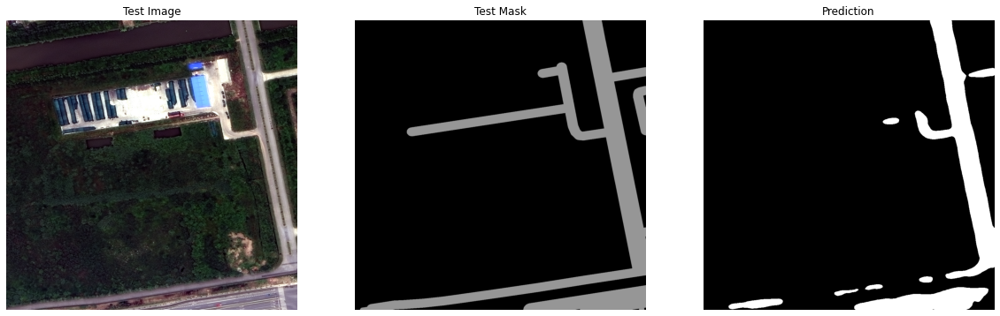

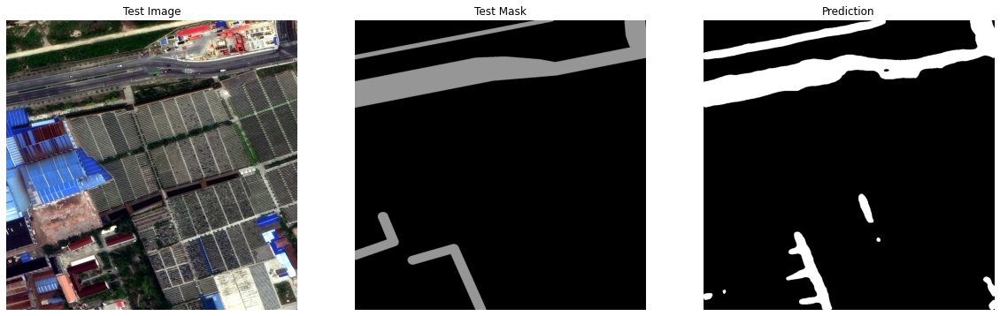

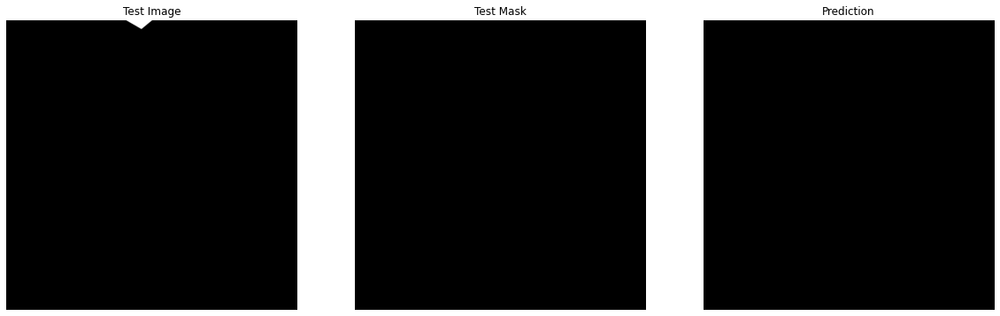

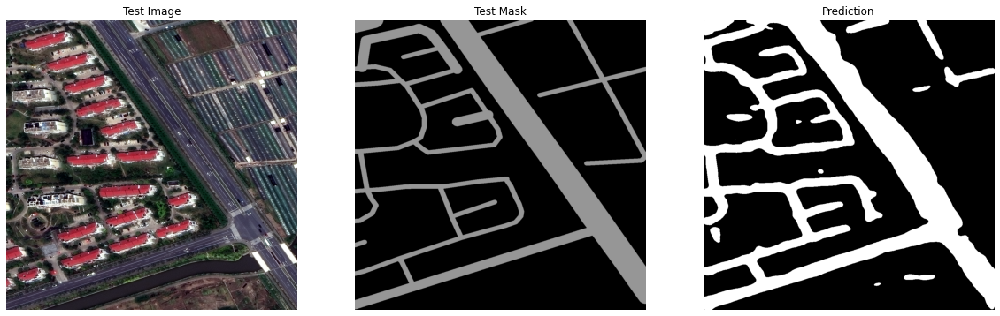

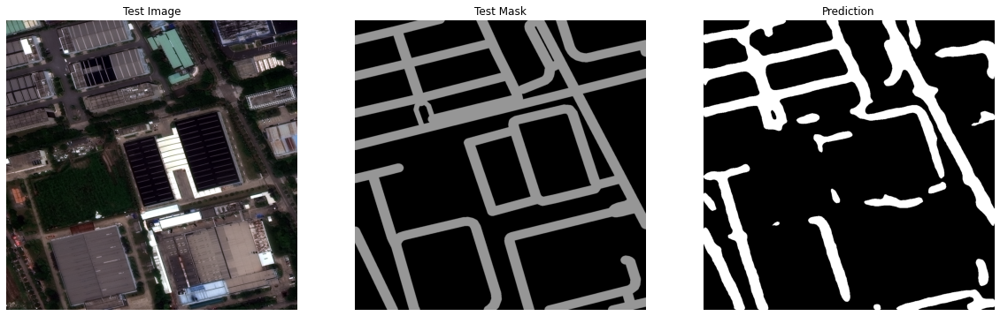

...

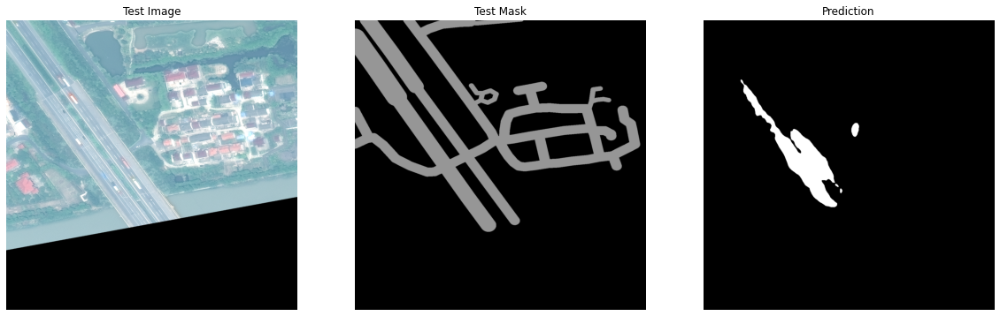

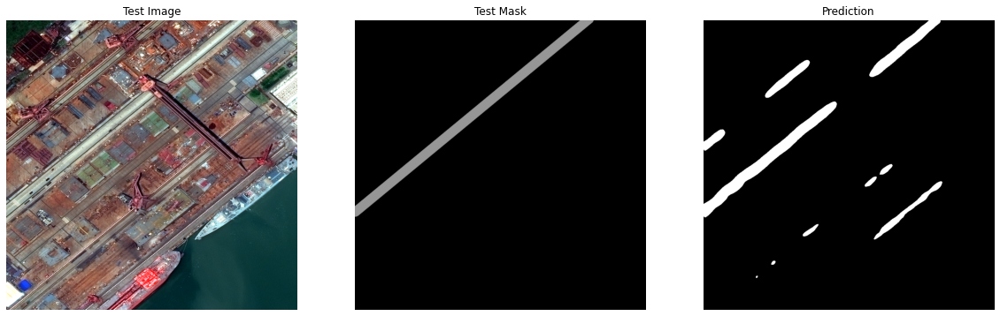

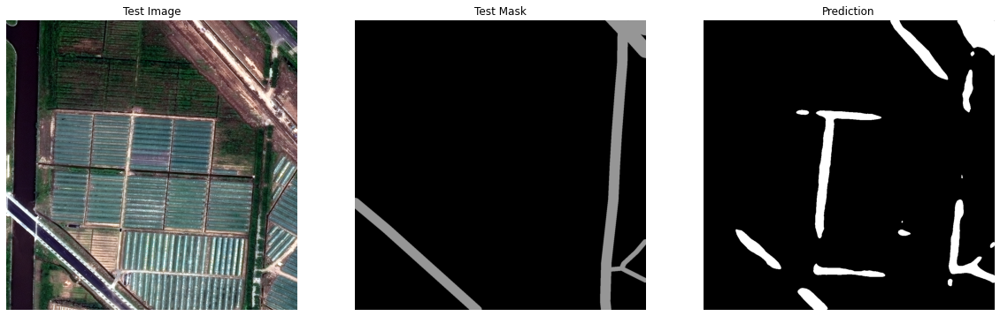

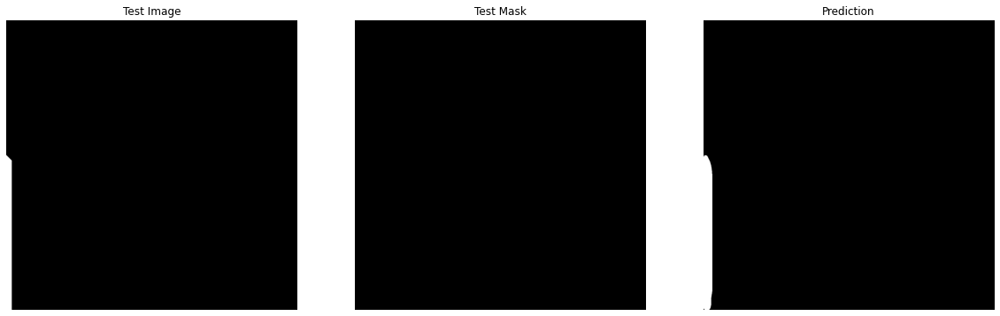

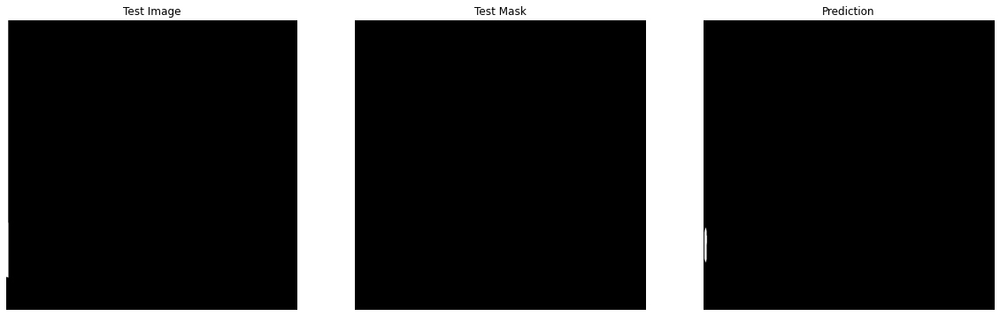

In [12]:
# plot the test image, the test mask, and the prediction
plot_test_pred(image_list, mask_list, pred, test_num = 61)

In [13]:
# get the F1 score of the prediction
F1_score(mask_list, pred)

0.6684787032426158